In [30]:
from pathlib import Path
import sys
import matplotlib.pyplot as plt
import matplotlib as mpl
from geopy.geocoders import Nominatim
import numpy as np
from scipy.cluster.hierarchy import single, complete, average, ward, dendrogram
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from yellowbrick.cluster import KElbowVisualizer
import pickle

import cartopy.crs as ccrs

import xarray as xr

from eofs.xarray import Eof

def plot_final_map(data, n=None):

    fig = plt.figure(figsize=(15,10))
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.stock_img()


    plt.scatter(x=data[data['labels']==n]['latitude'], y=data[data['labels']==n]['longitude'],
                color="red",
                s=10,
                alpha=0.5,
                transform=ccrs.PlateCarree())



    plt.show()
    return


class SearchingModelPath:

    def __init__(self, searching_model_path=None):
        self.searching_model_path = searching_model_path

    def searching_model_path(name: str):

        """Insert the name string of the model so i can reach for you"""
        try:
            path_home = Path.home()
            path_directory = path_home / 'Desktop/Unimib/Data Science/Second Year/Physics and environmental data lab/Environmental/Materiale Corso/Final_ex/final_exam_envi/Model Folder'
            path_model = path_directory / name
            if not path_model.exists():
                sys.exit()
            return path_model
        except SystemExit:
            print('Insert string and valid model name')


def searching_model_path(name: str):

    """Insert the name string of the model so i can reach for you"""
    try:
        path_home = Path.home()
        path_directory = path_home / 'Desktop/Unimib/Data Science/Second Year/Physics and environmental data lab/Environmental/Materiale Corso/Final_ex/final_exam_envi/Model Folder'
        path_model = path_directory / name
        if not path_model.exists():
            sys.exit()
        return path_model
    except SystemExit:
        print('Insert string and valid model name')

    return


def plot_part_of_map(ens,a,b,c,d):
    """Plot a part of a map"""

    d1_nat = ens.sel(lat=slice(a,b), lon=slice(c,d))
    psl_nat=d1_nat.ens_mean
    fig = plt.figure(figsize=(30,24))  # x,y(inches)

    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.set_title(''.join(['ciao','\n']))
    ax.set_global()
    mm = ax.contourf(psl_nat.lon, psl_nat.lat, psl_nat.mean(axis=0), transform=ccrs.PlateCarree(), cmap='jet')

    ax.coastlines()
    ax.gridlines(draw_labels=True)

    # add colorbar
    cbar_ax = fig.add_axes([0.28, 0.10, 0.46, 0.05])
    cbar = fig.colorbar(mm, cax=cbar_ax, extend='both', orientation='horizontal')
    # [left, bottom, width, height]
    cbar.set_label('Temperature')
    cbar.ax.tick_params(labelsize=8)

    plt.show()
    plt.close()

    return


def point(city: str):

    geolocator = Nominatim(user_agent="google")
    location = geolocator.geocode(city)
    print((location.latitude, location.longitude))
    lat = (int(location.latitude)+90)
    lon = (int(location.longitude)+180)
    box = int(((lat) * ((lon)))/2)
    ens = xr.load_dataset('/home/giodefa/Desktop/Unimib/Data Science/Second Year/Physics and environmental data '
                          'lab/Environmental/Materiale Corso/Final_ex/final_exam_envi/bozza/model_ens.nc')
    print(f"L'area selezionata è {location.address} e fa parte del cluster numero {kmeans.labels_[int(box)-1]} per il kmean mentre per il cluster gerarchico {cutree[int(box)-1][0]}")
    plot_part_of_map(ens,int(location.latitude),int(location.latitude)+2,int(location.longitude),int(location.longitude)+2)
    return


def hierarchical_clustering(distance_matrix, method='complete'):
    if method == 'complete':
        Z = complete(distance_matrix)
    if method == 'single':
        Z = single(distance_matrix)
    if method == 'average':
        Z = average(distance_matrix)
    if method == 'ward':
        Z = ward(distance_matrix)

    fig = plt.figure(figsize=(16, 8))
    dn = dendrogram(Z)
    plt.title(f"Dendrogram for {method}-linkage with correlation distance")
    plt.show()
    return Z


def select_numebr_of_cluster_and_plot(n=None):




    kmeans = KMeans(n_clusters=n, random_state=0).fit(data_mo)
    labels = kmeans.labels_




    fig = plt.figure()
    ax = fig.add_subplot(111, projection = '3d')
    ax = Axes3D(fig)


    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.set_zlabel("z")
    sns.set(style = "darkgrid")
    ax.scatter(principalComponents[::,0], principalComponents[::,1], principalComponents[::,2], c=labels)

    plt.show()

    sns.scatterplot(x=principalComponents[::,0], y=principalComponents[::,1], hue=labels, palette='bright')


    latitude = []
    longitude = []
    for j in range(-180,180,2):
        for i in range(-90,90,2):
            latitude.append(j)
            longitude.append(i)

    labels_dataframe_point = pd.DataFrame(labels,columns=['labels'])

    latitude = pd.DataFrame(latitude, columns=['latitude'])
    longitude = pd.DataFrame(longitude, columns=['longitude'])

    labels_dataframe_point = pd.concat([labels_dataframe_point,latitude,longitude],axis=1)

    for i in range(0,n):
        plot_final_map(labels_dataframe_point,i)

    return


def select_numebr_of_cluster_and_plot(data, n=None):




    kmeans = KMeans(n_clusters=n, random_state=0).fit(data)
    labels = kmeans.labels_


    x = StandardScaler().fit_transform(data_mo)
    pca = PCA(n_components=3)
    principalComponents = pca.fit_transform(x)

    fig = plt.figure()
    ax = fig.add_subplot(111, projection = '3d')
    ax = Axes3D(fig)


    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.set_zlabel("z")
    sns.set(style = "darkgrid")
    ax.scatter(principalComponents[::,0], principalComponents[::,1], principalComponents[::,2], c=labels)

    plt.show()

    sns.scatterplot(x=principalComponents[::,0], y=principalComponents[::,1], hue=labels, palette='bright')


    latitude = []
    longitude = []
    for j in range(-180,180,2):
        for i in range(-90,90,2):
            latitude.append(j)
            longitude.append(i)

    labels_dataframe_point = pd.DataFrame(labels,columns=['labels'])

    latitude = pd.DataFrame(latitude, columns=['latitude'])
    longitude = pd.DataFrame(longitude, columns=['longitude'])

    labels_dataframe_point = pd.concat([labels_dataframe_point,latitude,longitude],axis=1)

    for i in range(0,n):
        plot_final_map(labels_dataframe_point,i)

    return

def select_numebr_of_cluster_hier__and_plot(n=None):






    loaded_model = pickle.load(open(filename, 'rb'))
    cutree = cluster.hierarchy.cut_tree(loaded_model, n_clusters=n)

    latitude = []
    longitude = []
    for j in range(-180,180,2):
        for i in range(-90,90,2):
            latitude.append(j)
            longitude.append(i)

    labels_dataframe_point = pd.DataFrame(cutree,columns=['labels'])

    latitude = pd.DataFrame(latitude, columns=['latitude'])
    longitude = pd.DataFrame(longitude, columns=['longitude'])

    labels_dataframe_point = pd.concat([labels_dataframe_point,latitude,longitude],axis=1)

    for i in range(0,n):
        plot_final_map(labels_dataframe_point,i)

    return

In [31]:
# Import libraries
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

import cartopy.crs as ccrs
#from cartopy.util import add_cyclic_point

import xarray as xr

import numpy as np

from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter

from matplotlib import colorbar, colors

from eofs.xarray import Eof


from bozza.function import searching_model_path, SearchingModelPath, point, plot_part_of_map
import pandas as pd
from geopy.geocoders import Nominatim
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from yellowbrick.cluster import KElbowVisualizer

In questo script vengono caricati i modelli

In [ ]:
path_model_ts_amon_mri =  searching_model_path('ts_Amon_MRI-AGCM3-2-S_highresSST-present_r1i1p1f1_gn_201001-201412(3).nc')
path_model_ts_amon_mri_2h = searching_model_path('ts_Amon_MRI-AGCM3-2-H_highresSST-present_r1i1p1f1_gn_195001-201412.nc')

Vediamo che il modello seguente è suddiviso in più parti quindi andrà concatenato successivamente

In [ ]:
path_model_ts_amon_hiram_1 = searching_model_path('ts_Amon_HiRAM-SIT-HR_highresSST-present_r1i1p1f1_gn_200801-200812.nc')
path_model_ts_amon_hiram_2 = searching_model_path('ts_Amon_HiRAM-SIT-HR_highresSST-present_r1i1p1f1_gn_200901-200912.nc')
path_model_ts_amon_hiram_3 = searching_model_path('ts_Amon_HiRAM-SIT-HR_highresSST-present_r1i1p1f1_gn_201001-201012.nc')
path_model_ts_amon_hiram_4 = searching_model_path('ts_Amon_HiRAM-SIT-HR_highresSST-present_r1i1p1f1_gn_201101-201112.nc')
path_model_ts_amon_hiram_5 = searching_model_path('ts_Amon_HiRAM-SIT-HR_highresSST-present_r1i1p1f1_gn_201201-201212.nc')
path_model_ts_amon_hiram_6 = searching_model_path('ts_Amon_HiRAM-SIT-HR_highresSST-present_r1i1p1f1_gn_201301-201312.nc')
path_model_ts_amon_hiram_7 = searching_model_path('ts_Amon_HiRAM-SIT-HR_highresSST-present_r1i1p1f1_gn_201401-201412.nc')

In [11]:
model_hiram_1 = xr.open_dataset(path_model_ts_amon_hiram_1)

model_hiram = xr.concat([
    xr.open_dataset(path_model_ts_amon_hiram_1),
    xr.open_dataset(path_model_ts_amon_hiram_2),
    xr.open_dataset(path_model_ts_amon_hiram_3),
    xr.open_dataset(path_model_ts_amon_hiram_4),
    xr.open_dataset(path_model_ts_amon_hiram_5),
    xr.open_dataset(path_model_ts_amon_hiram_6),
    xr.open_dataset(path_model_ts_amon_hiram_7),
], dim = "time")
model_hiram = model_hiram.sel(time=slice('2010-01','2014-12'))

Proviamo a visualizzare le surface temperature all'interno del nostro modello

In [15]:
model_mri = xr.open_dataset(path_model_ts_amon_mri)
temperature_surface_mri = model_mri.ts - 273.15
temperature_surface_mri

<xarray.DataArray 'ts' (time: 60, lat: 960, lon: 1920)>
array([[[-25.986008, -25.988113, -25.990234, ..., -25.996384,
         -26.000198, -25.984344],
        [-25.796295, -25.799194, -25.801743, ..., -25.807358,
         -25.80893 , -25.794983],
        [-25.550644, -25.550278, -25.549347, ..., -25.557587,
         -25.554108, -25.55362 ],
        ...,
        [-36.694595, -36.693253, -36.692307, ..., -36.696823,
         -36.696182, -36.695297],
        [-36.55638 , -36.555283, -36.554016, ..., -36.557205,
         -36.556564, -36.557037],
        [-36.403458, -36.404434, -36.403473, ..., -36.403366,
         -36.404037, -36.403214]],

       [[-36.971893, -36.957718, -36.962097, ..., -36.969025,
         -36.971222, -36.974716],
        [-36.81317 , -36.800186, -36.802475, ..., -36.805832,
         -36.808   , -36.811447],
        [-36.56662 , -36.5661  , -36.56488 , ..., -36.57144 ,
         -36.568604, -36.5679  ],
...
        [-26.289917, -26.287537, -26.294586, ..., -26.28447 ,
         -26.290253, -26.287277],
        [-26.31073 , -26.301743, -26.307419, ..., -26.307129,
         -26.302475, -26.303055],
        [-26.336807, -26.341797, -26.337555, ..., -26.345703,
         -26.34018 , -26.33841 ]],

       [[-24.08371 , -24.084045, -24.085358, ..., -24.08287 ,
         -24.084259, -24.085861],
        [-24.049332, -24.048172, -24.050674, ..., -24.042877,
         -24.044907, -24.047165],
        [-23.943542, -23.945343, -23.946823, ..., -23.93547 ,
         -23.937592, -23.94107 ],
        ...,
        [-29.64746 , -29.639542, -29.652939, ..., -29.640182,
         -29.65422 , -29.64476 ],
        [-29.631165, -29.611526, -29.618652, ..., -29.62912 ,
         -29.617691, -29.617554],
        [-29.65355 , -29.664673, -29.657303, ..., -29.668213,
         -29.658585, -29.654633]]], dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 2010-01-16T12:00:00 ... 2014-12-16T12:00:00
  * lat      (lat) float64 -89.86 -89.67 -89.48 -89.3 ... 89.3 89.48 89.67 89.86
  * lon      (lon) float64 0.0 0.1875 0.375 0.5625 ... 359.2 359.4 359.6 359.8

In [21]:
print(f'il numero di lon è {len(temperature_surface_mri.lon)} e il numero di lat è {len(temperature_surface_mri.lat)}')

il numero di lon è 1920 e il numero di lat è 960


In [22]:
print(f'il numero di lon è {len(temperature_surface_model_hiram.lon)} e il numero di lat è {len(temperature_surface_model_hiram.lat)}')

il numero di lon è 1536 e il numero di lat è 768


Di seguito possiamo osservare la temperatura media nel periodo preso in considerazione

Text(0.5, 1.0, 'Temperature')

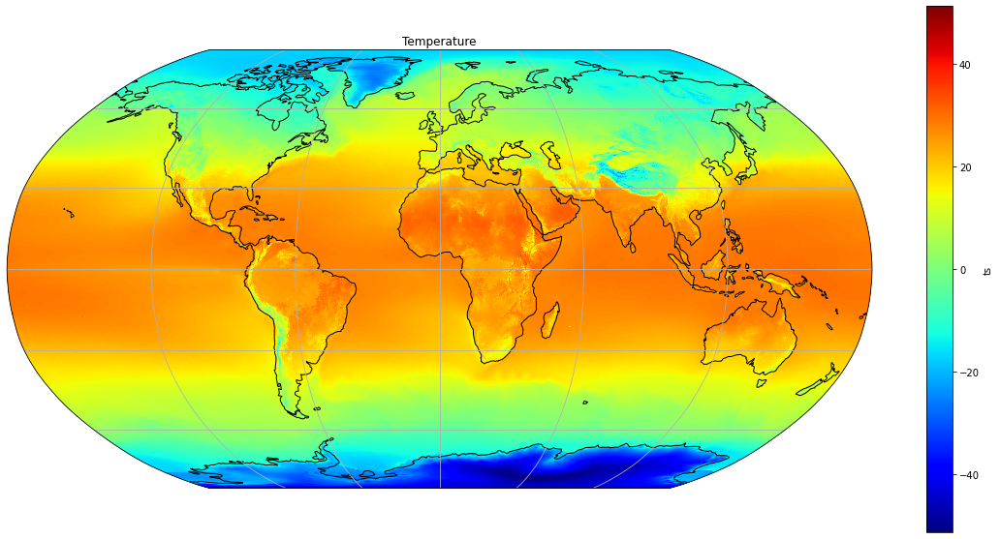

In [23]:
fig = plt.figure(figsize=(20, 10))
p0 = temperature_surface_mri.mean('time').plot(transform=ccrs.PlateCarree(),subplot_kws={'projection': ccrs.Robinson()},
                      360/resol      cmap='jet')
p0.axes.coastlines()
p0.axes.gridlines()
plt.rcParams["figure.figsize"] = (10,10)
plt.title('Temperature' )

# Project


- L'idea è quella di utilizzare due modelli della temperatura superficiale ad alta risoluzione e applicare due metodi di clusterizzazione. Quindi verrà applicato un kmeans e un clustering gerarchico sulle serie temporali mediante il confronto delle stesse mediante Time warping.
- Più precisamente verranno calcolate le anomalie su cinque anni e prese le medie dei due modelli. Quindi il modello verrà suddiviso in griglie e successivamente verranno clusterizzate queste informazioni con i metodi sopra descritti.

Quindi carichiamo il modello e selezioniamo soltanto le date che ci interessano

In [20]:
model_hiram_1 = xr.open_dataset(path_model_ts_amon_hiram_1)

model_hiram = xr.concat([
    xr.open_dataset(path_model_ts_amon_hiram_1),
    xr.open_dataset(path_model_ts_amon_hiram_2),
    xr.open_dataset(path_model_ts_amon_hiram_3),
    xr.open_dataset(path_model_ts_amon_hiram_4),
    xr.open_dataset(path_model_ts_amon_hiram_5),
    xr.open_dataset(path_model_ts_amon_hiram_6),
    xr.open_dataset(path_model_ts_amon_hiram_7),
], dim = "time")
model_hiram = model_hiram.sel(time=slice('2010-01','2014-12'))



Di seguito osserviamo la media aggregata sul tempo e sulla longitudine, quindi l'informazione che abbiamo è una temperatura per latitudine, difatti possiamo notare come spostandoci verso i poli la temperatura diminuisce

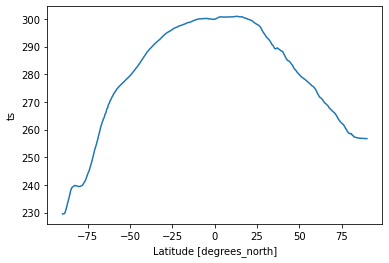

In [21]:
model_hiram.ts.mean(('time','lon')).plot()

Quindi di seguito calcoliamo le anomalie solo di un modello con la media descritta precedentemente

In [22]:
model_hiram['anomaly'] = (model_hiram.ts - 273) - (model_hiram.ts.mean(('time','lon'))- 273)

Text(0.5, 1.0, 'Temperature')

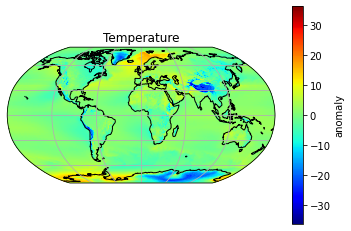

In [23]:


p0 = model_hiram.anomaly.mean('time').plot(transform=ccrs.PlateCarree(),subplot_kws={'projection': ccrs.Robinson()},
                            cmap='jet')
p0.axes.coastlines()
p0.axes.gridlines()
plt.rcParams["figure.figsize"] = (10,10)
plt.title('Temperature' )



Ora poichè uno dei modelli ha una minor quantità di suddivisioni in latitudine e longitudine procediamo con l'interpolazione, in questo modo potremo utilizzare i due modelli ensamble

In [ ]:
model_mri_interp = model_mri.copy()
model_mri_interp = model_mri_interp.interp(lat=model_hiram.lat, lon=model_hiram.lon, method='linear')

In [12]:
print(f'il numero di lon è {len(model_mri_interp.lon)} e il numero di lat è {len(model_mri_interp.lat)}')
print(f'il numero di lon è {len(model_hiram.lon)} e il numero di lat è {len(model_hiram.lat)}')

il numero di lon è 1536 e il numero di lat è 768
il numero di lon è 1536 e il numero di lat è 768


Ora creiamo il nuovo modello, in questo modo abbiamo una nuova variabile ts2 che ci descrive la temperatura del secondo modello.
E con il comando drop eliminiamo le informazioni superflue

In [17]:
ens = model_mri_interp.merge(model_hiram.ts.rename('ts2'))
ens = ens.drop_vars(('lat_bnds','lon_bnds','time_bnds'))
ens

<xarray.Dataset>
Dimensions:  (time: 60, lat: 768, lon: 1536)
Coordinates:
  * time     (time) datetime64[ns] 2010-01-16T12:00:00 ... 2014-12-16T12:00:00
  * lat      (lat) float64 -89.88 -89.65 -89.41 -89.18 ... 89.41 89.65 89.88
  * lon      (lon) float64 0.1172 0.3516 0.5859 0.8203 ... 359.4 359.6 359.9
Data variables:
    ts       (time, lat, lon) float64 nan nan nan nan nan ... nan nan nan nan
    ts2      (time, lat, lon) float32 246.0 246.0 246.0 ... 245.8 245.8 245.8
Attributes: (12/36)
    Conventions:           CF-1.7 CMIP-6.2
    activity_id:           HighResMIP
    branch_method:         no parent
    creation_date:         2019-06-12T08:35:27Z
    data_specs_version:    01.00.23
    experiment:            forced atmosphere experiment for 1950-2014
    ...                    ...
    title:                 MRI-AGCM3-2-S output prepared for CMIP6
    variable_id:           ts
    variant_label:         r1i1p1f1
    license:               CMIP6 model data produced by MRI is licensed under...
    cmor_version:          3.3.2
    tracking_id:           hdl:21.14100/bdb472b5-bfd5-4ec7-84c3-cfcb3291f310

Ora calcoliamo le anomalie dei due modelli e droppiamo le ts

In [18]:
ens['ts_anomaly'] = (ens.ts - 273) - (ens.ts.mean(('time','lon'))-273)
ens['ts2_anomaly'] =( ens.ts2 - 273) - (ens.ts2.mean(('time','lon')) - 273)
ens = ens.drop_vars(('ts','ts2'))
ens

<xarray.Dataset>
Dimensions:      (time: 60, lat: 768, lon: 1536)
Coordinates:
  * time         (time) datetime64[ns] 2010-01-16T12:00:00 ... 2014-12-16T12:...
  * lat          (lat) float64 -89.88 -89.65 -89.41 -89.18 ... 89.41 89.65 89.88
  * lon          (lon) float64 0.1172 0.3516 0.5859 0.8203 ... 359.4 359.6 359.9
Data variables:
    ts_anomaly   (time, lat, lon) float64 nan nan nan nan ... nan nan nan nan
    ts2_anomaly  (time, lat, lon) float32 16.51 16.51 16.51 ... -10.95 -10.95
Attributes: (12/36)
    Conventions:           CF-1.7 CMIP-6.2
    activity_id:           HighResMIP
    branch_method:         no parent
    creation_date:         2019-06-12T08:35:27Z
    data_specs_version:    01.00.23
    experiment:            forced atmosphere experiment for 1950-2014
    ...                    ...
    title:                 MRI-AGCM3-2-S output prepared for CMIP6
    variable_id:           ts
    variant_label:         r1i1p1f1
    license:               CMIP6 model data produced by MRI is licensed under...
    cmor_version:          3.3.2
    tracking_id:           hdl:21.14100/bdb472b5-bfd5-4ec7-84c3-cfcb3291f310

ora calcolo le medie delle anomalie

In [19]:
ens_mean = ens.to_array(dim='new').mean('new')
ens_stdev = ens.to_array(dim='new2').std('new2')

ens['ens_mean'] = ens_mean  # convert to Celsius
ens['ens_stdev'] = ens_stdev
ens = ens.drop_vars(('ts_anomaly','ts2_anomaly'))

ens.coords['lon'] = (ens.coords['lon'] + 180) % 360 - 180
ens = ens.sortby(ens.lon)

ens

<xarray.Dataset>
Dimensions:    (time: 60, lat: 768, lon: 1536)
Coordinates:
  * time       (time) datetime64[ns] 2010-01-16T12:00:00 ... 2014-12-16T12:00:00
  * lat        (lat) float64 -89.88 -89.65 -89.41 -89.18 ... 89.41 89.65 89.88
  * lon        (lon) float64 -179.9 -179.6 -179.4 -179.2 ... 179.4 179.6 179.9
Data variables:
    ens_mean   (time, lat, lon) float64 16.32 16.32 16.32 ... -10.97 -10.97
    ens_stdev  (time, lat, lon) float64 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
Attributes: (12/36)
    Conventions:           CF-1.7 CMIP-6.2
    activity_id:           HighResMIP
    branch_method:         no parent
    creation_date:         2019-06-12T08:35:27Z
    data_specs_version:    01.00.23
    experiment:            forced atmosphere experiment for 1950-2014
    ...                    ...
    title:                 MRI-AGCM3-2-S output prepared for CMIP6
    variable_id:           ts
    variant_label:         r1i1p1f1
    license:               CMIP6 model data produced by MRI is licensed under...
    cmor_version:          3.3.2
    tracking_id:           hdl:21.14100/bdb472b5-bfd5-4ec7-84c3-cfcb3291f310

In [21]:
ens.to_netcdf('./model_ens.nc')

E decido di plottare le informazioni ottenute, quindi all'interno del plot possiamo osservare le zone con differenze positive o meno delle temperature

Text(0.5, 1.0, 'Temperature')

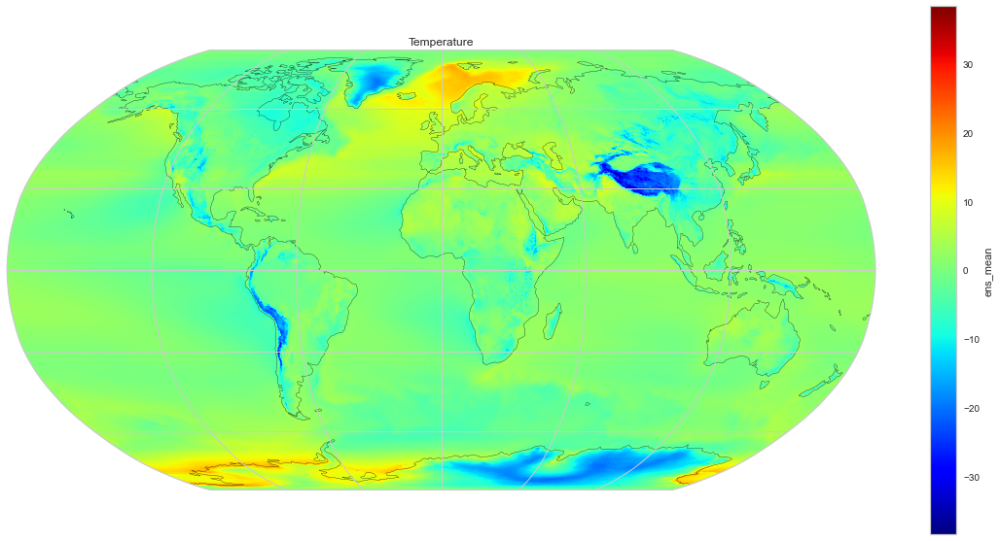

In [20]:
fig = plt.figure(figsize=(20, 10))
p0 = ens.ens_mean.mean('time').plot(transform=ccrs.PlateCarree(),subplot_kws={'projection': ccrs.Robinson()},
                            cmap='jet')
p0.axes.coastlines()
p0.axes.gridlines()
plt.rcParams["figure.figsize"] = (10,10)
plt.title('Temperature' )

Ora decido di visualizzare le medie delle temperature aggregando sullo spazio, quindi visualizzerò una media globale.
Posso osservare una leggera tendenza all'aumento delle anomalie nel tempo

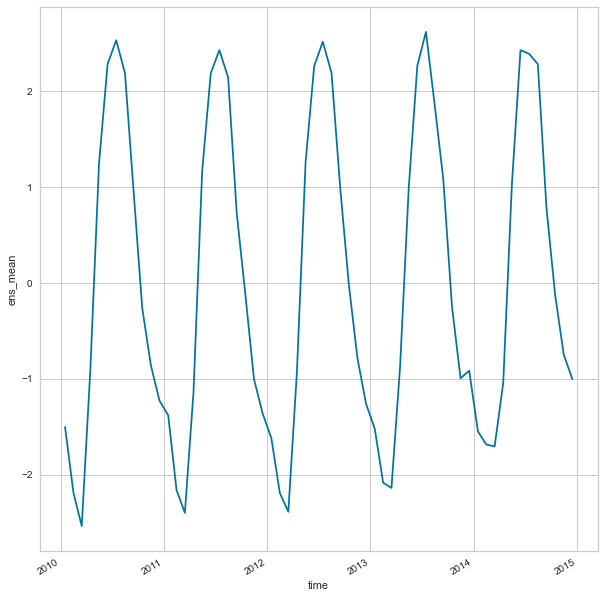

In [25]:
ens.ens_mean.mean(('lat','lon')).plot()

All'interno di questo grafico invece decido di visualizzare un quarto della superficie terrestre

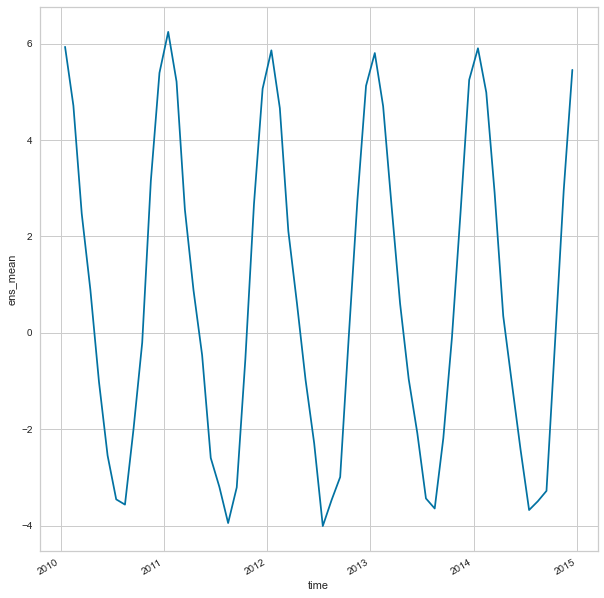

In [24]:
ens.ens_mean.sel(lon=slice(-90,0),lat=slice(-180,0)).mean(('lat','lon')).plot()

Visualizzo un'altra griglia

In [117]:
data_mo[0] = np.array(ens.ens_mean.sel(lat=slice(-90,-89),lon=slice(-180,-179)).mean(('lat','lon'))).reshape(1,60)

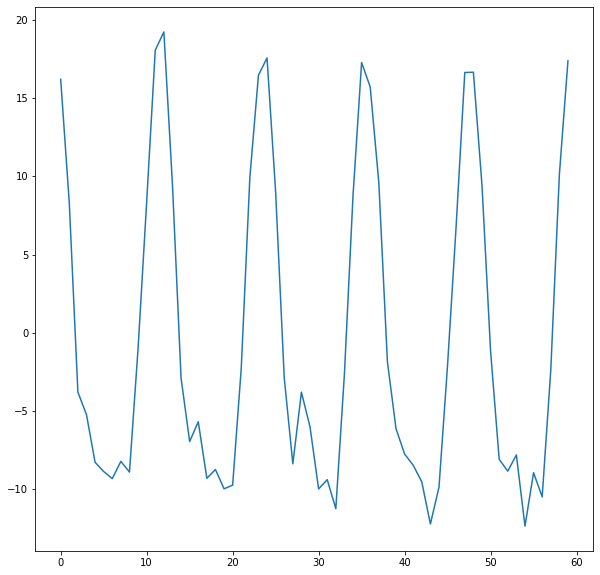

In [118]:
plt.plot(data_mo[0])

Ora decido di prendere le mie informazioni per griglia, quindi sto visualizzando un punto sulla terra e le anomalie di quel punto per i 5 anni presi in considerazione

In [43]:
ens.ens_mean.sel(lat=slice(-90,-89),lon=slice(-180,-179))

<xarray.DataArray 'ens_mean' (time: 60, lat: 4, lon: 4)>
array([[[ 16.31614685,  16.31614685,  16.31614685,  16.31614685],
        [ 16.63427823,  16.63386717,  16.6324583 ,  16.63701095],
        [ 16.13918019,  16.14230952,  16.14293284,  16.14706516],
        [ 15.75355994,  15.75824665,  15.76021752,  15.76632319]],

       [[  9.76705933,   9.76705933,   9.76705933,   9.76705933],
        [  8.07203307,   8.07618534,   8.07543308,   8.07351152],
        [  7.78570834,   7.78939497,   7.79316114,   7.79189636],
        [  7.56288491,   7.56723425,   7.56688502,   7.5704051 ]],

       [[ -2.13668823,  -2.13668823,  -2.13668823,  -2.13668823],
        [ -3.9248046 ,  -3.92825037,  -3.92297112,  -3.92566818],
        [ -4.34687697,  -4.34548711,  -4.34711399,  -4.34399727],
        [ -4.8023131 ,  -4.80004705,  -4.80203516,  -4.80048795]],

       [[ -4.85971069,  -4.85971069,  -4.85971069,  -4.85971069],
        [ -5.34084119,  -5.34704005,  -5.3319269 ,  -5.3385731 ],
        [ -5.32713444,  -5.32150996,  -5.31786223,  -5.32299578],
        [ -5.4491003 ,  -5.44878623,  -5.44151707,  -5.45057745]],

...

       [[ -9.90852356,  -9.90852356,  -9.90852356,  -9.90852356],
        [-10.54301255, -10.54812045, -10.53505812, -10.54176699],
        [-10.64668732, -10.63886519, -10.64170476, -10.63636207],
        [-10.94732463, -10.93491528, -10.93175043, -10.92190302]],

       [[ -4.58998108,  -4.58998108,  -4.58998108,  -4.58998108],
        [ -1.3811472 ,  -1.3796202 ,  -1.37858141,  -1.37780409],
        [ -1.67275771,  -1.66934757,  -1.66638514,  -1.66276797],
        [ -2.00904508,  -2.00420784,  -2.00091841,  -1.99464105]],

       [[  9.29023743,   9.29023743,   9.29023743,   9.29023743],
        [ 10.84875341,  10.85086846,  10.8510535 ,  10.85254112],
        [ 10.37898922,  10.38374413,  10.38592493,  10.38919476],
        [  9.94526335,   9.95151716,   9.9560929 ,   9.96012235]],

       [[ 16.95362854,  16.95362854,  16.95362854,  16.95362854],
        [ 17.95179446,  17.9523423 ,  17.95374265,  17.95494085],
        [ 17.52330587,  17.52645151,  17.52920629,  17.53241938],
        [ 17.14684666,  17.15153601,  17.15458061,  17.16087221]]])
Coordinates:
  * time     (time) datetime64[ns] 2010-01-16T12:00:00 ... 2014-12-16T12:00:00
  * lat      (lat) float64 -89.88 -89.65 -89.41 -89.18
  * lon      (lon) float64 -179.9 -179.6 -179.4 -179.2

Ora creo la mia tabella con 16200 righe, cioè tutta la suddivisione del modello e 60 colonne, cioè il numero di mesi present in 5 anni.

In [22]:
resol = 2#5 # degrees (E and N)
nlon = np.int(360/resol)
nlat = np.int(180/resol)
data_mo = np.empty([nlat*nlon, 60],dtype=float)
data_mo.shape

/tmp/ipykernel_26125/1175393650.py:2: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  nlon = np.int(360/resol)
/tmp/ipykernel_26125/1175393650.py:3: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more 

(16200, 60)

Carico i miei dati sfruttando due cicli for, uno sulla latitudine e uno sulla longitudine

In [23]:
# Iterate over grid cells and
# - get the average time series of all stations in grid cell at month resolution
# - integrate to annual resolution
c = 0
for j in range(-180,180,2):
  for i in range(-90,90,2):

      data_mo[c] = np.array(ens.ens_mean.sel(lat=slice(i,i+2),lon=slice(j,j+2)).mean(('lat','lon'))).reshape(1,60)
      c += 1


# Analysis

Di seguito carico i dati inerenti ad i box presenti all'interno del modello embedded e carico i dati delle distanze, si vedrà di seguito come è stata ottenuta quella matrice

In [3]:
data_mo = np.load('/home/giodefa/Desktop/Unimib/Data Science/Second Year/Physics and environmental data lab/Environmental/Materiale Corso/Final_ex/final_exam_envi/bozza/array_comp_16200.npy')
distance_matrix = np.load('/home/giodefa/Desktop/Unimib/Data Science/Second Year/Physics and environmental data lab/Environmental/Materiale Corso/Final_ex/final_exam_envi/bozza/distance_matrix.npy')
#ens =xr.load_dataset('/home/giodefa/Desktop/Unimib/Data Science/Second Year/Physics and environmental data lab/Environmental/Materiale Corso/Final_ex/final_exam_envi/bozza/model_ens.nc')

Decido di analizzare il mio Dataset prima di tutto scalandolo e poi applico una PCA sul mio dataset e proverò ad estrarre il numero più coerente di cluster osservando alcune metriche dispobibili

In [33]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

x = StandardScaler().fit_transform(data_mo)


In [34]:
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)

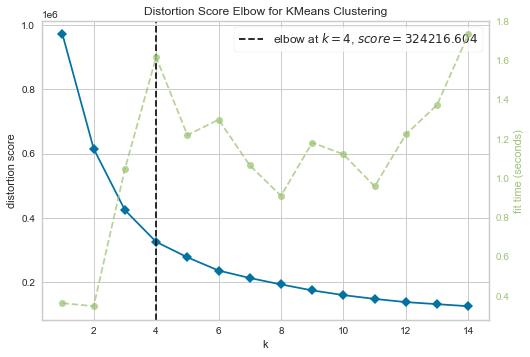

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [150]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from yellowbrick.cluster import KElbowVisualizer


model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,15))

visualizer.fit(x)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

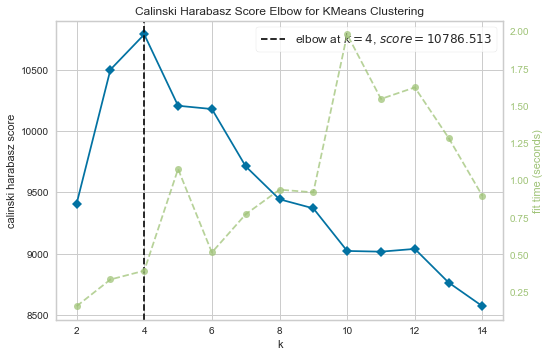

<AxesSubplot:title={'center':'Calinski Harabasz Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='calinski harabasz score'>

In [143]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from yellowbrick.cluster import KElbowVisualizer


model = KMeans()
visualizer = KElbowVisualizer(model,metric='calinski_harabasz', k=(2,15))

visualizer.fit(x)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

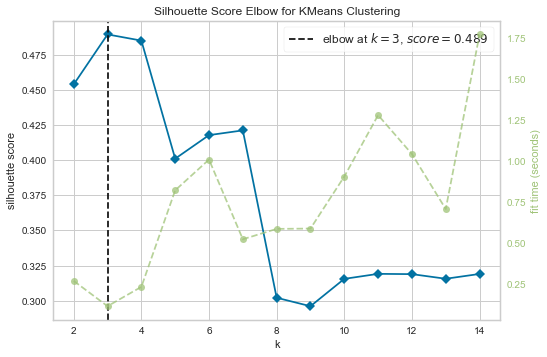

<AxesSubplot:title={'center':'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [144]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from yellowbrick.cluster import KElbowVisualizer


model = KMeans()
visualizer = KElbowVisualizer(model,metric='silhouette', k=(2,15))

visualizer.fit(x)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

Osservando i risultati dell'analisi decido di utilizzare 4 cluster, almeno per una prima analisi

Quindi applico l'algoritmo di Kmeans e visualizzo i dati ottenuti

In [35]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=4, random_state=0).fit(data_mo)
labels = kmeans.labels_

/tmp/ipykernel_29384/2082365781.py:7: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


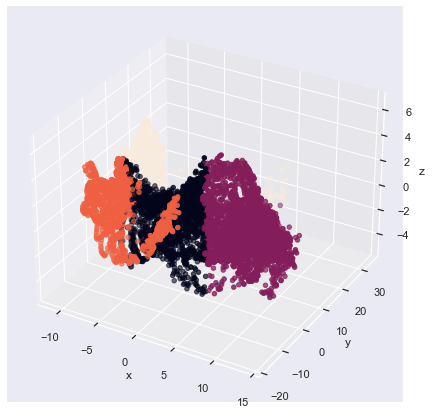

In [36]:
from mpl_toolkits.mplot3d import Axes3D



fig = plt.figure()
ax = fig.add_subplot(111, projection = '3d')
ax = Axes3D(fig)


ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_zlabel("z")
sns.set(style = "darkgrid")
ax.scatter(principalComponents[::,0], principalComponents[::,1], principalComponents[::,2], c=labels)

plt.show()

<AxesSubplot:>

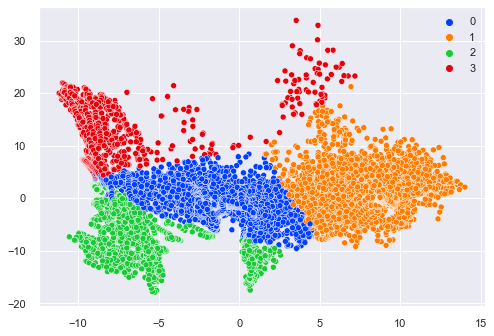

In [37]:
sns.scatterplot(x=principalComponents[::,0], y=principalComponents[::,1], hue=labels, palette='bright')

Ora volendo plottare i risultati sulla mappa, decido di creare un dataset ad hoc, dove per ogni punto abbiamo il risultato della clusterizzazione e la posizione nello spazio

In [39]:
latitude = []
longitude = []
for j in range(-180,180,2):
    for i in range(-90,90,2):
        latitude.append(j)
        longitude.append(i)

In [39]:
def search_position():
    latitude = []
    longitude = []
    for j in range(-180,180,2):
        for i in range(-90,90,2):
            latitude.append(j)
            longitude.append(i)
    return latitude,longitude

In [40]:
labels_dataframe_point = pd.DataFrame(labels,columns=['labels'])

latitude = pd.DataFrame(latitude, columns=['latitude'])
longitude = pd.DataFrame(longitude, columns=['longitude'])

labels_dataframe_point = pd.concat([labels_dataframe_point,latitude,longitude],axis=1)

labels_dataframe_point

,labels,latitude,longitude
0,2,-180,-90
1,2,-180,-88
2,2,-180,-86
3,2,-180,-84
4,2,-180,-82
...,...,...,...
16195,1,178,80
16196,1,178,82
16197,1,178,84
16198,1,178,86


Ora posso pensare di unire tutti i vari passaggi in un'unica funzione che mi permette di decidere il numero di cluster e plottarli automaticamente, in questo modo posso valutare le varie suddivisioni

/tmp/ipykernel_27519/2306795869.py:198: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


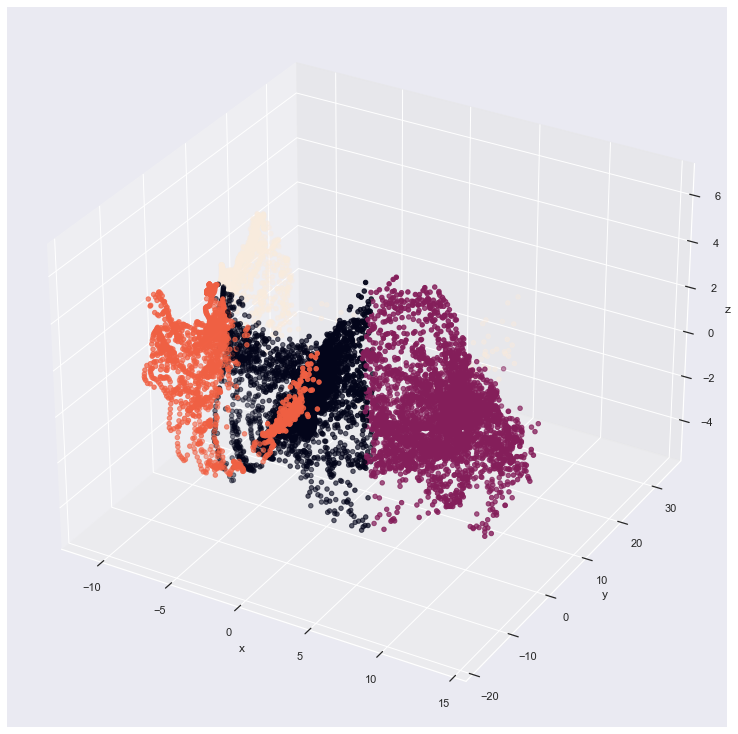

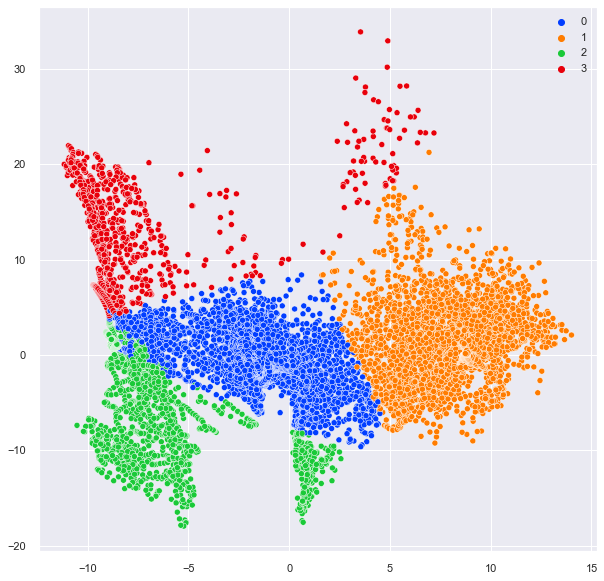

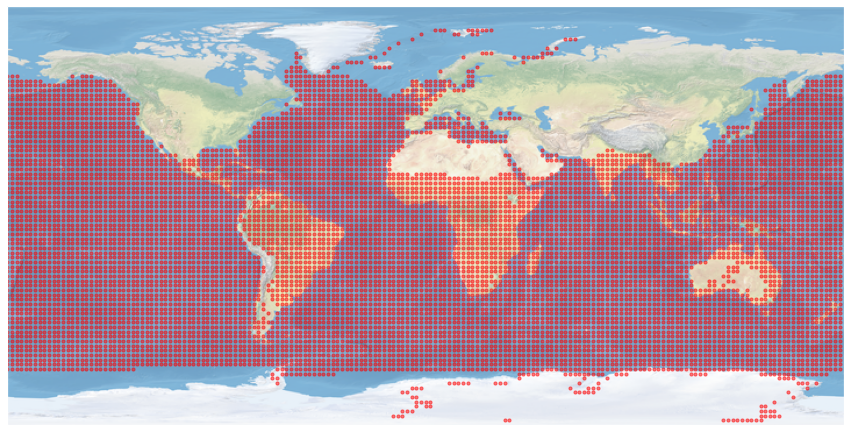

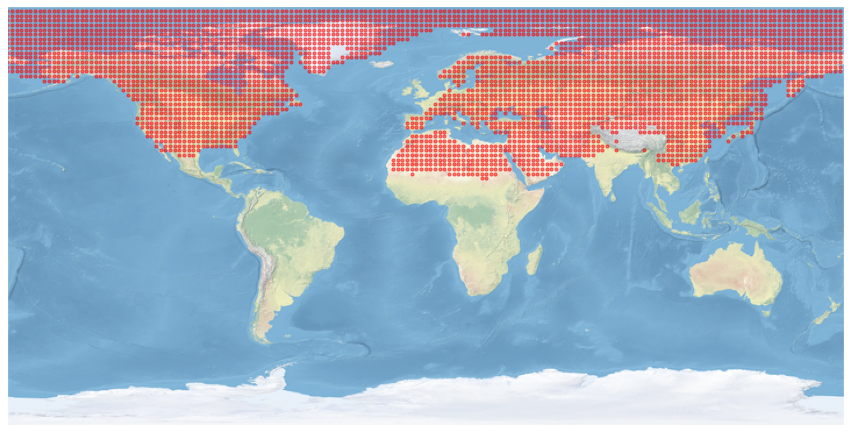

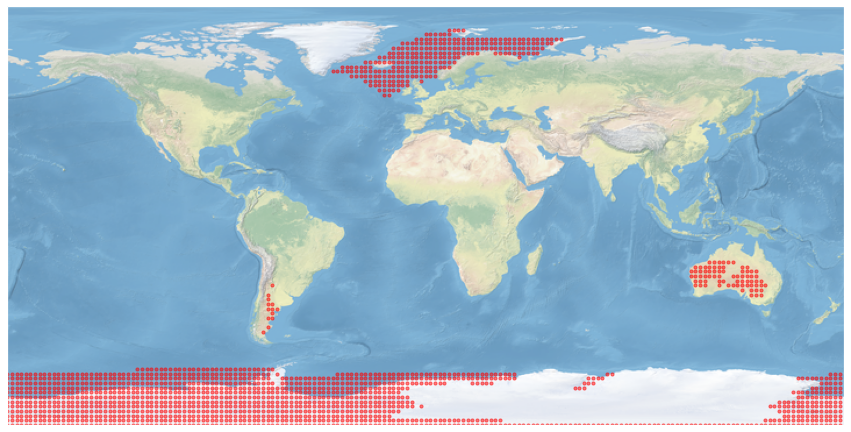

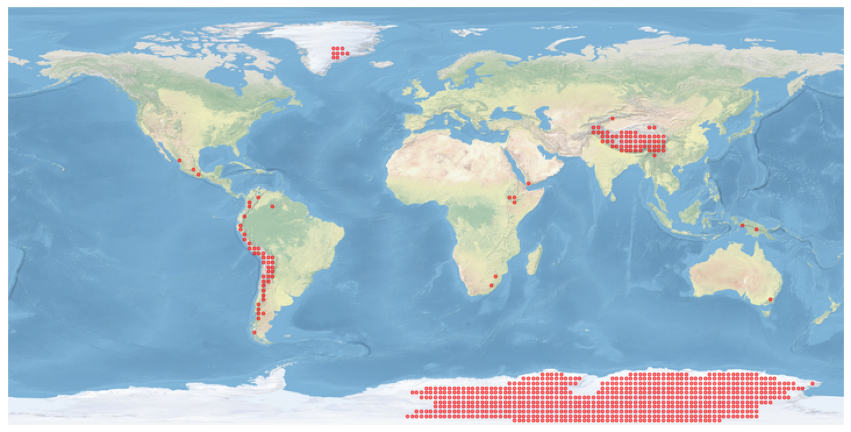

In [30]:
select_numebr_of_cluster_and_plot(data_mo,4)

Successivamente decido di applicare uno studio sulle serie storiche attraverso l'utilizo della Dynamic Time Warping, quindi verranno messe a confronto tutte le serie storiche punto per punto e verrà valutata la distanza tra queste, il tutto verrà salvato all'interno della variabile distance matrix che servirà più avanti per l'applicazione di un algoritmo gerarchico.

In [ ]:
from dtaidistance import dtw


n_series = len(data_mo)
distance_matrix = np.zeros(shape=(n_series, n_series))
distance_matrix = dtw.distance_matrix_fast(data_mo)
np.save('distance_matrix.npy',distance_matrix)

/home/giodefa/anaconda3/envs/final_exam_envi/lib/python3.10/site-packages/scipy/cluster/hierarchy.py:364: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  return linkage(y, method='complete', metric='euclidean')


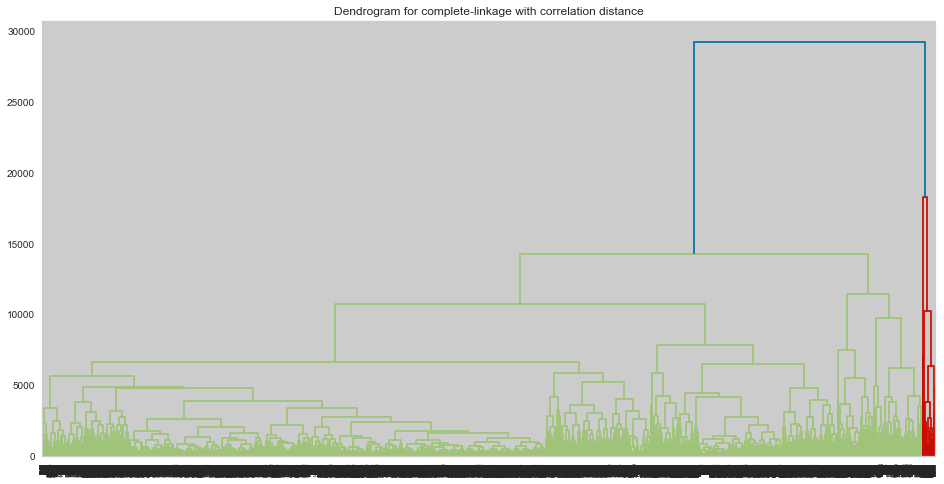

In [4]:
linkage_matrix = hierarchical_clustering(distance_matrix, method='complete')

Di seguito viene visualizzato il dendogramma contenente tutti i punti, quindi punti vicini vengono piano piano uniti fino all'unione di tutti i punti presenti nel dataset

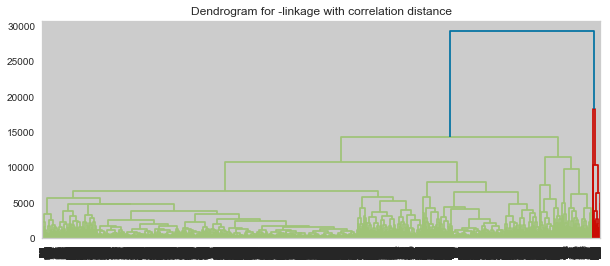

In [13]:
fig = plt.figure(figsize=(10, 4))
dn = dendrogram(loaded_model)
plt.title(f"Dendrogram for -linkage with correlation distance")
plt.show()

In [ ]:
# save the model to disk
filename = 'hir.sav'
pickle.dump(linkage_matrix, open(filename, 'wb'))

# some time later...


In [12]:

# load the model from disk
loaded_model = pickle.load(open(filename, 'rb'))
type(loaded_model)

numpy.ndarray

Di seguito viene tagliato il dendogramma per avere 6 cluster.

In [14]:
from scipy import cluster

cutree = cluster.hierarchy.cut_tree(loaded_model, n_clusters=6)

Posso quindi visualizzare e decidere dove tagliare il dendogramma, sicuramente per così tanti punti il metodo di clusterizzazione gerarchica non sembra essere il più adatto, infatti la maggior parte dei punti viene unita ad un livello molto basso, rendendo difficile l'analisi

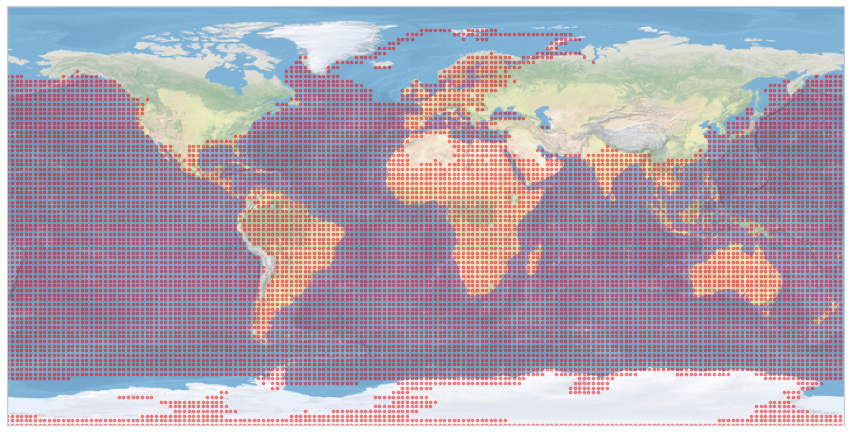

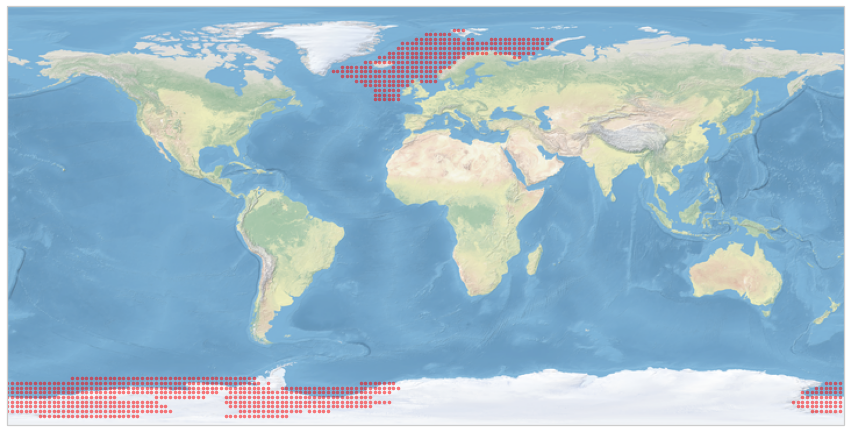

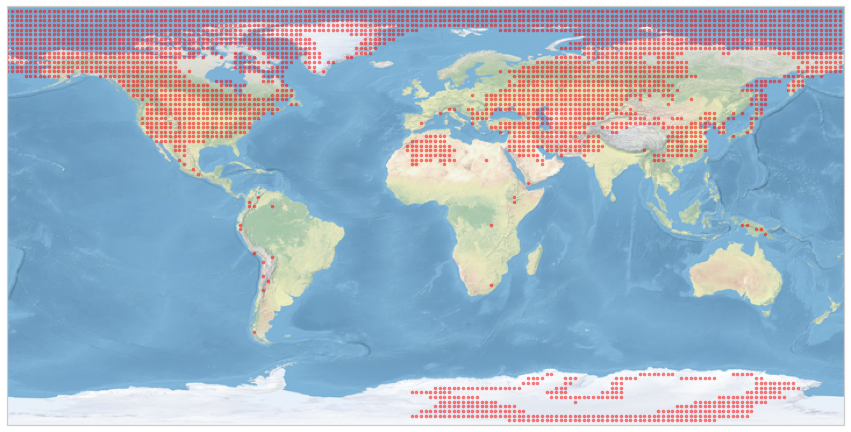

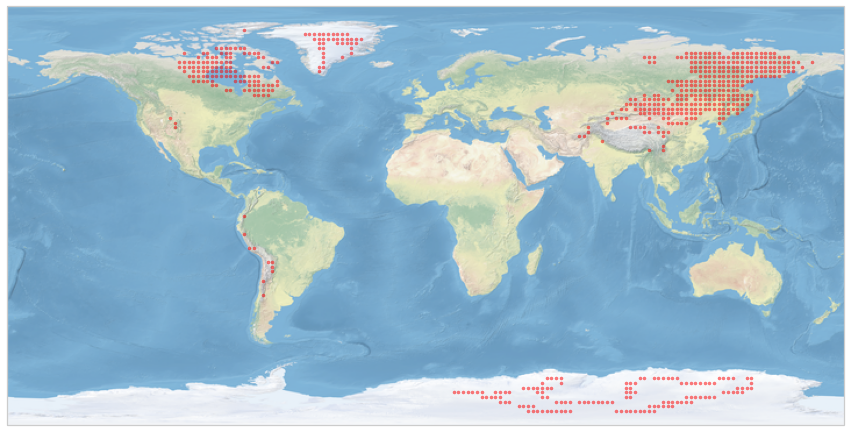

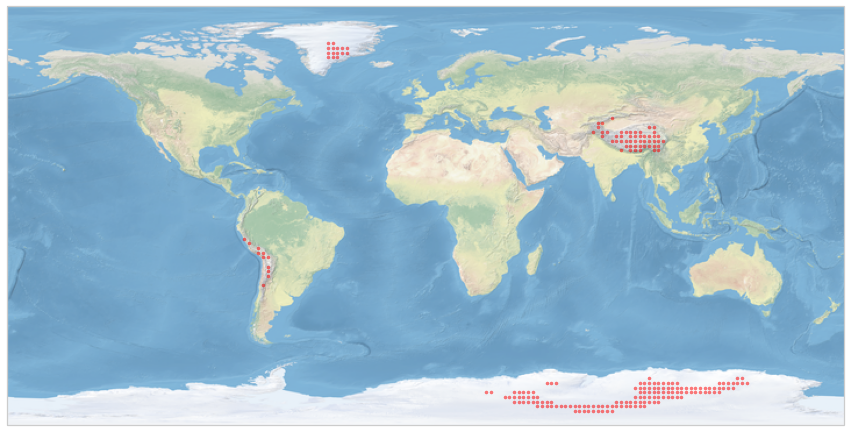

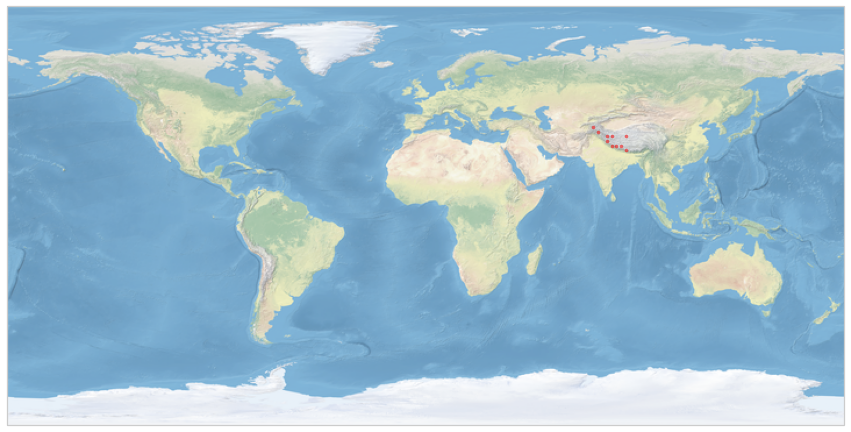

In [26]:
select_numebr_of_cluster_hier__and_plot(6)

All'interno di questo progetto sono state messe alla prova due metodi di clusterizzazione non supervisionato, questo potrebbe aprire la porta ad analisi più specifiche, magari anche analisi di clusterizzazione spaziale, analisi che non è stata proposta in questo breve lavoro.

# Print cluster

Di seguito provo a plottare un po' di esempi differenti

/tmp/ipykernel_29384/2010146477.py:199: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


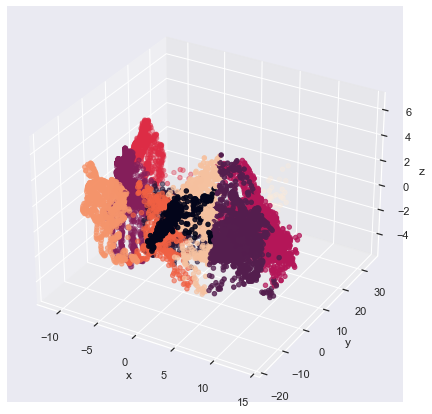

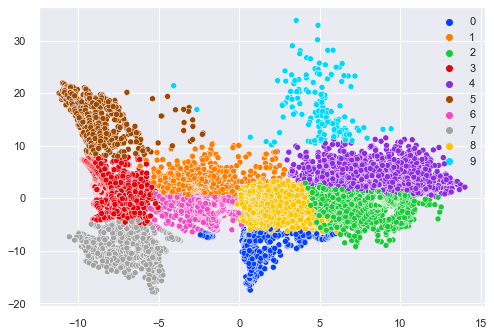

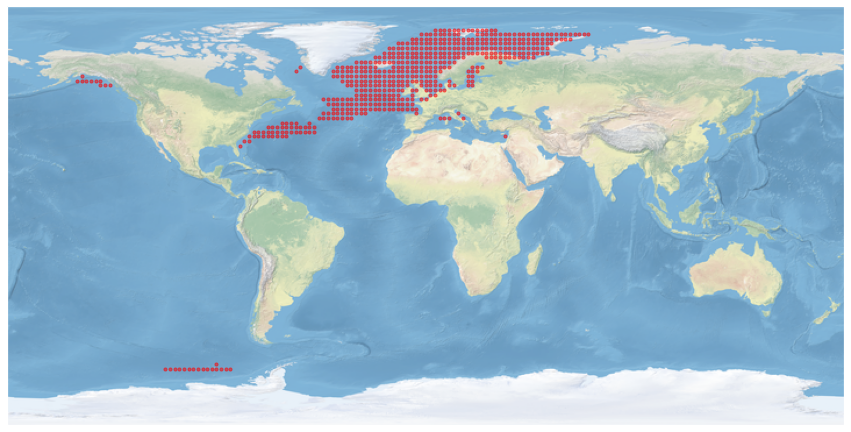

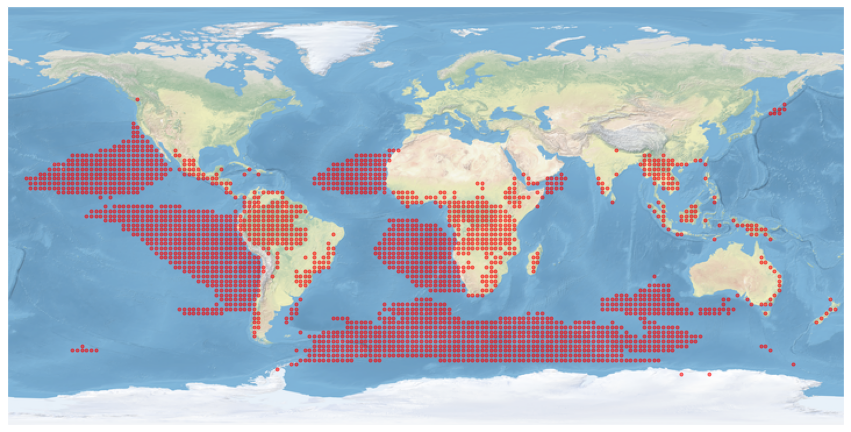

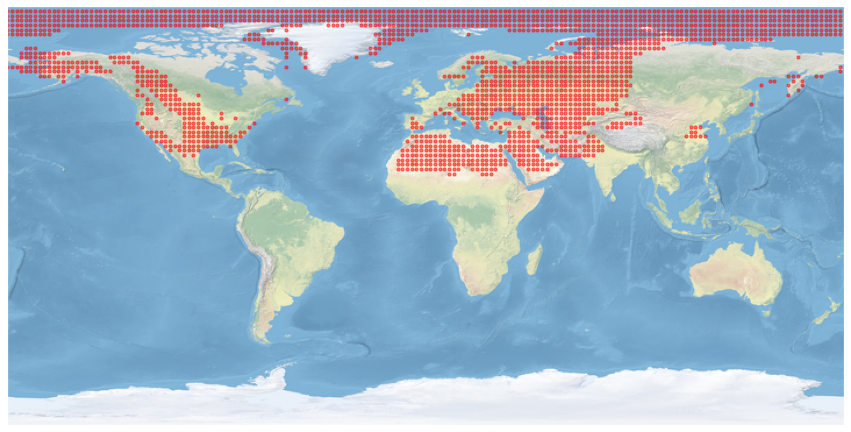

...

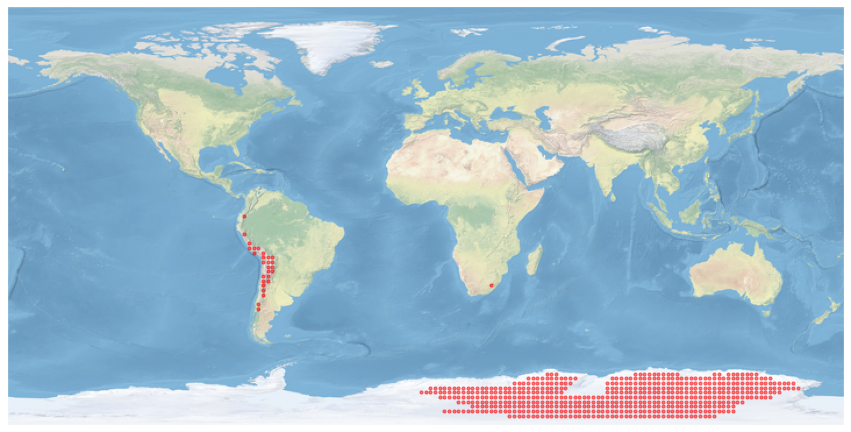

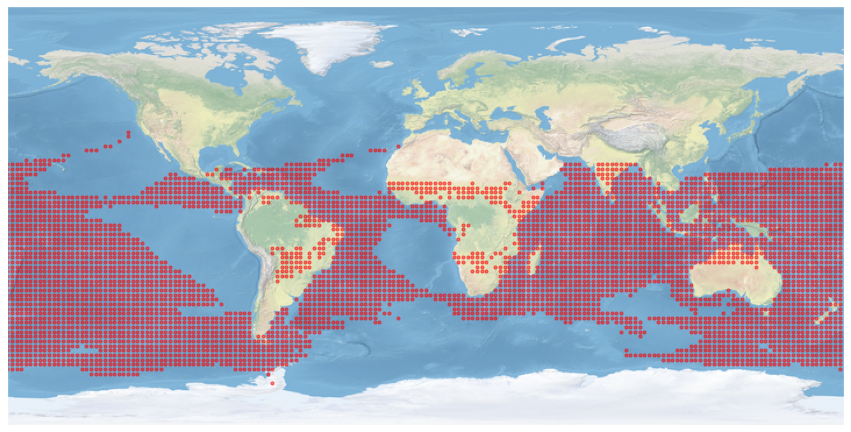

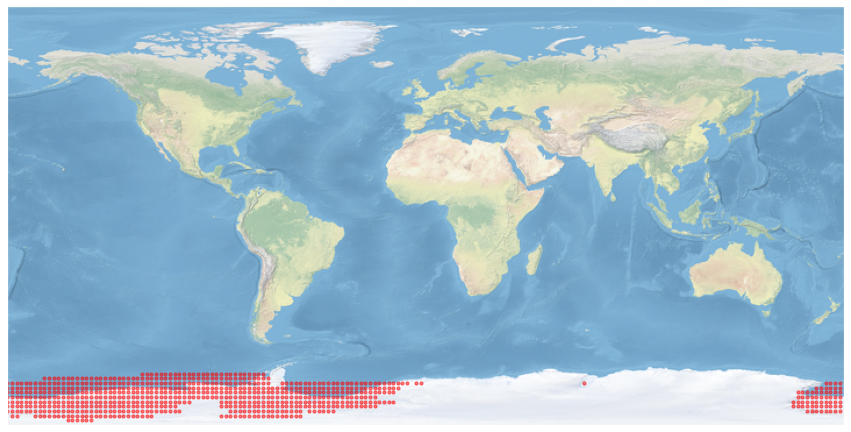

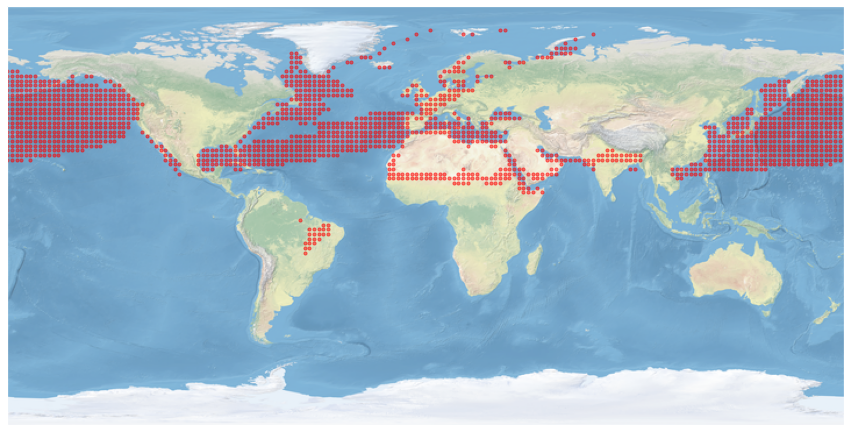

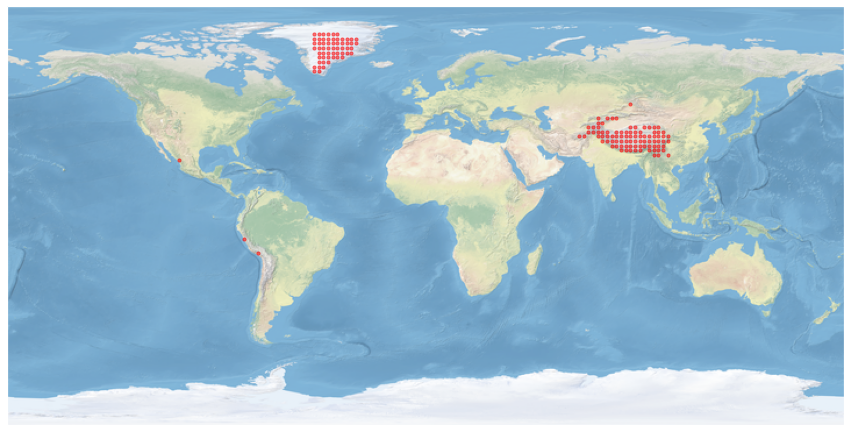

In [41]:
select_numebr_of_cluster_and_plot(data_mo,10)

/tmp/ipykernel_29384/2010146477.py:199: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = Axes3D(fig)


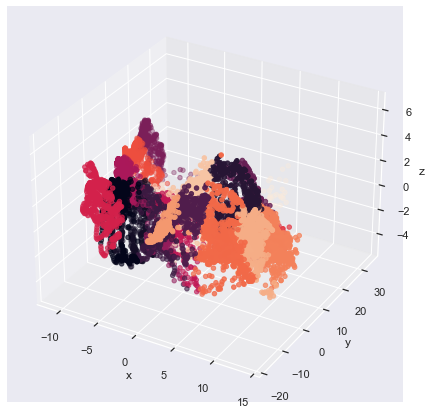

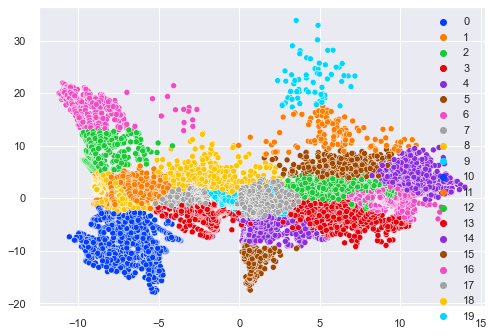

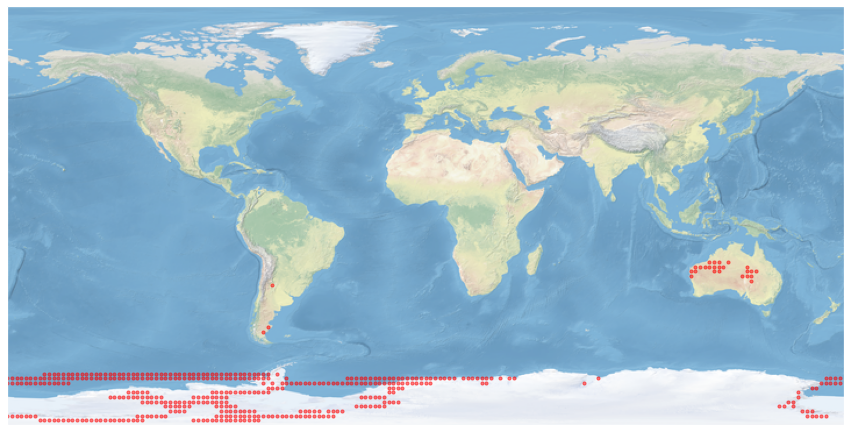

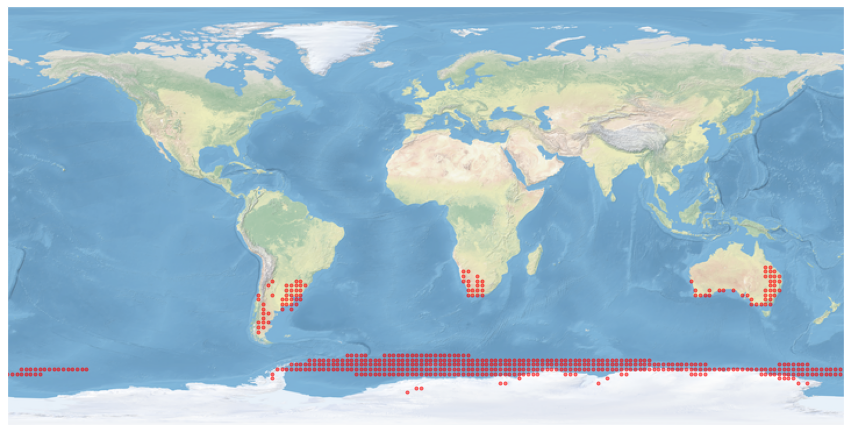

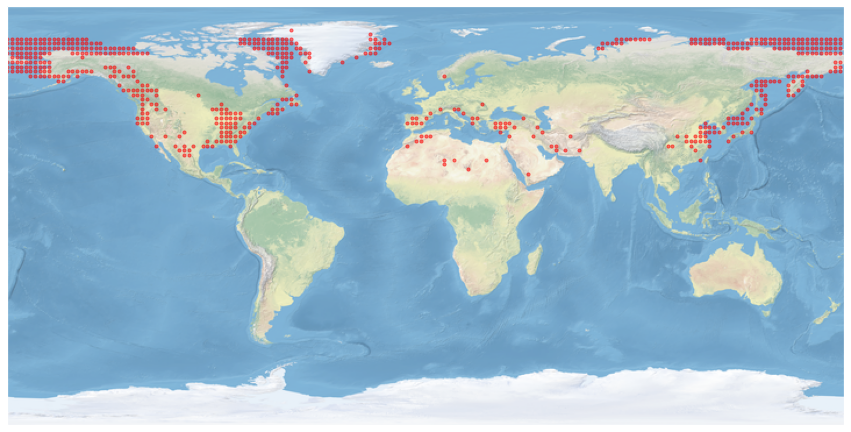

...

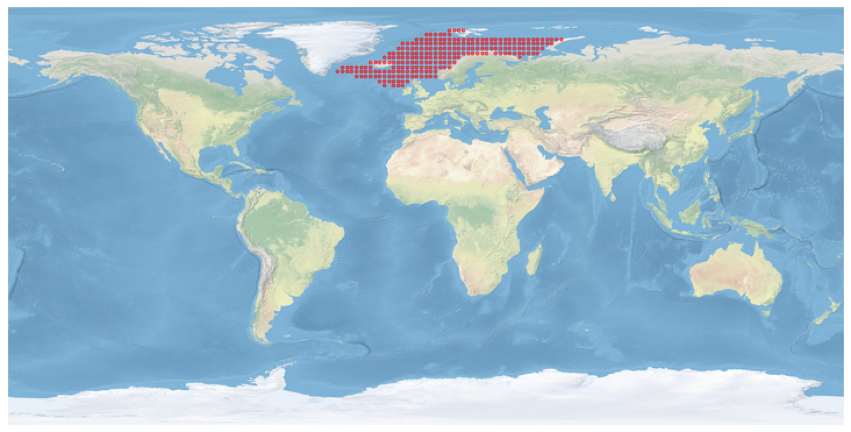

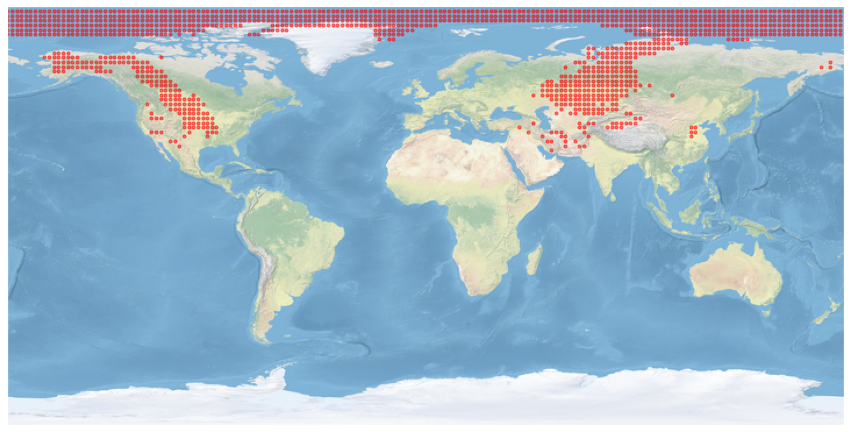

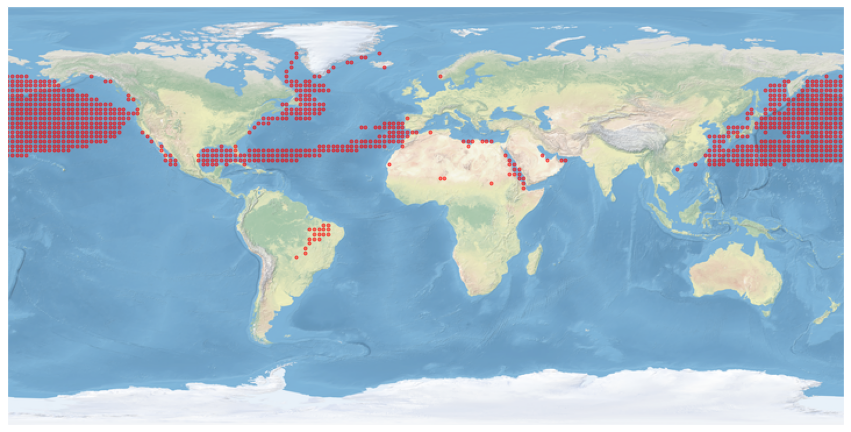

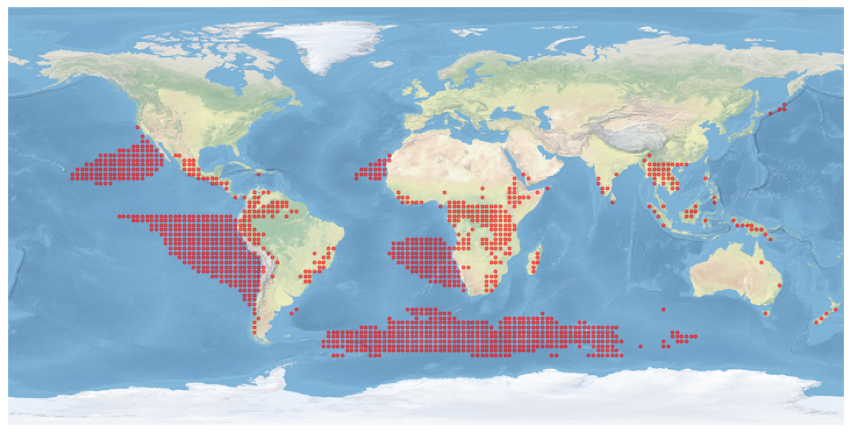

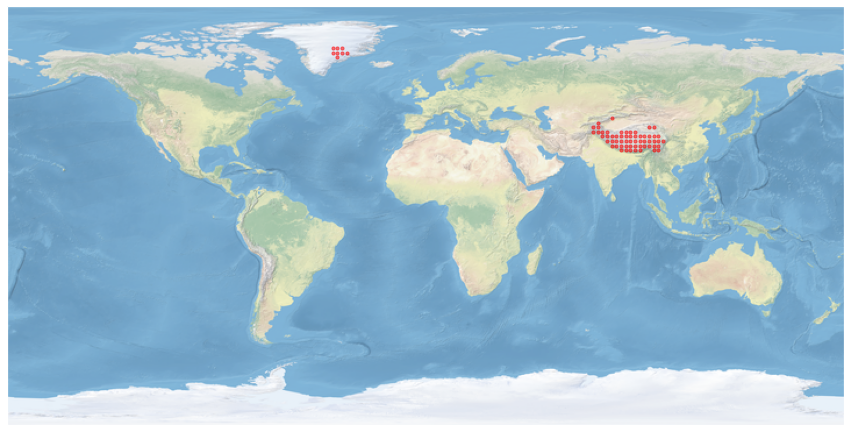

In [42]:
select_numebr_of_cluster_and_plot(data_mo, 20)